**Welcome to Olist dataset**

**Olist’s Business Model**

Olist (https://olist.com) is a Brazilian departmental store (marketplace) that operates in e-commerce segment, but is not an e-commerce itself (as she says). It operates as a SaaS (Software as a Service) technology company since 2015. It offers a marketplace solution (of e-commerce segment) to shopkeepers of all sizes (and for most segments) to increase their sales whether they have online presence or not.

Olist says she:

- is a large department store within marketplaces.
  
- is connected to the main e-commerces of Brazil.

- does not buy products.

- does not keep products in stock.

- does not carry out shipping of any products offered in its store.

All products are sold and shipped by the thousands of shopkeepers (registered on Olist) who sell through Olist. Her strength lies in union of all participating shopkeepers, who are selling physical products. Participant shopkeeper is responsible for separating, packing, and taking products to the logistics operator.

Please note Olist’s perspective (a supply chain preview): she prescribes there are many factors that can influence the sales of a shopkeeper e.g. type of product, demand, seasonality, competitive pricing, terms, inventory etc.

In [1]:
# Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')

import seaborn as sns
%matplotlib inline
from matplotlib.gridspec import GridSpec
pd.set_option('display.max_columns', 100)
import plotly.offline as py
import plotly.express as px
import plotly.graph_objs as go
# jupyter labextension install @jupyterlab/plotly-extension
import plotly.express as px
import json
import requests
from IPython.display import Image

**1. Overview**

Data source: https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce/data

This is a Brazilian ecommerce public dataset of orders made at Olist. 
   - The dataset has information of 100k orders from 2016 to 2018 made in Brazil.
     
   - Its features allows viewing an order from multiple dimensions: 
        
        + Order status
        
        + Price
        
        + Payment
        
        + Freight value 
        
        + Customer location
        
        + Product attributes
        
        + Customer reviews
        
        + Geolocation dataset that relates Brazilian zip codes to lat/long coordinates.
    
There are some different data sources, each one describing a specific topic related to e-commerce sales. The relationship between these files are described on the schema below. 

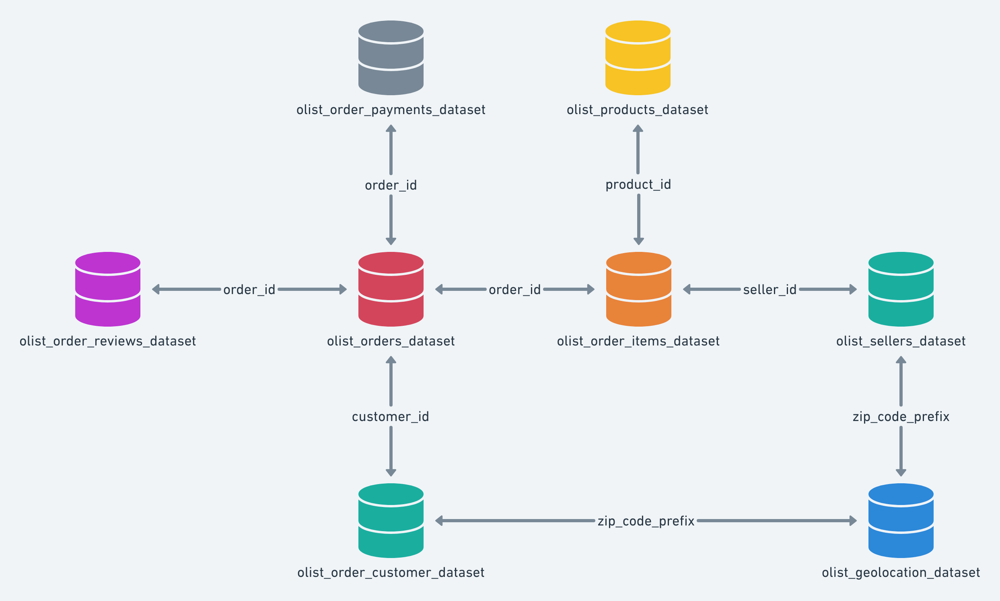

In [2]:
# Data schema
Image(filename='../data/metadata/schema.png') 

#### 1.1. Loading data

In [3]:
raw_path = '../data/raw/'
olist_customer = pd.read_csv(raw_path + 'olist_customers_dataset.csv')
olist_geolocation = pd.read_csv(raw_path + 'olist_geolocation_dataset.csv')
olist_orders = pd.read_csv(raw_path + 'olist_orders_dataset.csv')
olist_order_items = pd.read_csv(raw_path + 'olist_order_items_dataset.csv')
olist_order_payments = pd.read_csv(raw_path + 'olist_order_payments_dataset.csv')
olist_order_reviews = pd.read_csv(raw_path + 'olist_order_reviews_dataset.csv')
olist_products = pd.read_csv(raw_path + 'olist_products_dataset.csv')
olist_sellers = pd.read_csv(raw_path + 'olist_sellers_dataset.csv')
olist_product_category_translation = pd.read_csv(raw_path + 'product_category_name_translation.csv')

As our dataset is not too big, we could join all datasets (except Geolocation data) to create a single Master data to do our analysis easier. Note that there is a small number of customers who do not make any orders (~0.5%), so that we use `inner join` between these datasets.

In [4]:
olist = (olist_orders
         .merge(olist_customer, on='customer_id')
         .merge(olist_order_items, on='order_id')
         .merge(olist_order_payments, on='order_id')
         .merge(olist_order_reviews, on='order_id')
         .merge(olist_products, on='product_id')
         .merge(olist_sellers, on='seller_id')
         .merge(olist_product_category_translation, on='product_category_name'))

In [5]:
olist.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115609 entries, 0 to 115608
Data columns (total 40 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   order_id                       115609 non-null  object 
 1   customer_id                    115609 non-null  object 
 2   order_status                   115609 non-null  object 
 3   order_purchase_timestamp       115609 non-null  object 
 4   order_approved_at              115595 non-null  object 
 5   order_delivered_carrier_date   114414 non-null  object 
 6   order_delivered_customer_date  113209 non-null  object 
 7   order_estimated_delivery_date  115609 non-null  object 
 8   customer_unique_id             115609 non-null  object 
 9   customer_zip_code_prefix       115609 non-null  int64  
 10  customer_city                  115609 non-null  object 
 11  customer_state                 115609 non-null  object 
 12  order_item_id                 

#### 1.2. Cleaning data

- There are some datetime columns, which are currently in STRING datatype, it should be converted into DATETIME format for later uses.

In [6]:
datetime_cols = [c for c in olist.columns if ('timestamp' in c) or ('date' in c)] + ['order_approved_at']
for col in datetime_cols:
    olist[col] = olist[col].apply(pd.to_datetime)

* There are some columns contains specific name, these values should be converted into `title` format to look better on the charts

In [7]:
olist['customer_city'] = olist['customer_city'].str.title()
olist['seller_city'] = olist['seller_city'].str.title()
olist['product_category_name_english'] = olist['product_category_name_english'].str.title().str.replace('_', ' ')
olist['payment_type'] = olist['payment_type'].str.replace('_', ' ').str.title()

* Adding some more essential columns

In [8]:
olist['review_response_time'] = (olist['review_answer_timestamp'] - olist['review_creation_date']).dt.days
olist['time_to_delivery'] = (olist['order_delivered_customer_date'] - olist['order_purchase_timestamp']).dt.days
olist['delivery_against_estimated'] = (olist['order_delivered_customer_date'] - olist['order_estimated_delivery_date']).dt.days
olist['product_volume_cm'] = olist['product_length_cm'] * olist['product_height_cm'] * olist['product_width_cm']

# Datetime parts
olist['order_purchase_year'] = olist.order_purchase_timestamp.dt.year
olist['order_purchase_year_month'] = olist.order_purchase_timestamp.dt.strftime('%Y%m')
olist['order_purchase_hour'] = olist.order_purchase_timestamp.dt.hour
olist['order_purchase_month'] = olist.order_purchase_timestamp.dt.month.map({
    1: 'Jan',
    2: 'Feb',
    3: 'Mar',
    4: 'Apr',
    5: 'May', 
    6: 'Jun',
    7: 'Jul',
    8: 'Aug',
    9: 'Sep',
    10: 'Oct',
    11: 'Nov',
    12: 'Dec'
})
olist['order_purchase_dayofweek'] = olist.order_purchase_timestamp.dt.dayofweek.map({
    0: 'Mon',
    1: 'Tue',
    2: 'Wed',
    3: 'Thu',
    4: 'Fri',
    5: 'Sat',
    6: 'Sun'
})

In [9]:
olist.to_csv('../data/processed/olist.csv', index=False)

**2. EDA**

#### 2.1. Univariate analysis

Exploratory Data Analysis (EDA) could be simple with `pandas.describe()` function. I created a table summarizing the data quality in terms of Null and Unique values. Another option is using pre-built data profiling tool such as `ydata-profiling`.

In [10]:
data_quality_check = pd.DataFrame({})
for i, col in enumerate(olist.columns):
    data_quality_check.loc[i, 'ColumnName'] = col
    data_quality_check.loc[i, 'DataType'] = olist[col].dtype
    data_quality_check.loc[i, 'NumOfNull'] = olist[col].isnull().sum()
    data_quality_check.loc[i, 'NullPercentage'] = round(olist[col].isnull().sum() / olist.shape[0] * 100, 0)
    data_quality_check.loc[i, 'NumOfUniqueValues'] = olist[col].nunique()
    data_quality_check.loc[i, 'MostCommonValue'] = olist[col].mode()[0]

data_quality_check.style.background_gradient()

,ColumnName,DataType,NumOfNull,NullPercentage,NumOfUniqueValues,MostCommonValue
0,order_id,object,0.000000,0.000000,96516.000000,895ab968e7bb0d5659d16cd74cd1650c
1,customer_id,object,0.000000,0.000000,96516.000000,270c23a11d024a44c896d1894b261a83
2,order_status,object,0.000000,0.000000,7.000000,delivered
3,order_purchase_timestamp,datetime64[ns],0.000000,0.000000,95989.000000,2017-08-08 20:26:31
4,order_approved_at,datetime64[ns],14.000000,0.000000,88332.000000,2017-08-08 20:43:31
5,order_delivered_carrier_date,datetime64[ns],1195.000000,1.000000,79241.000000,2017-08-10 11:58:14
6,order_delivered_customer_date,datetime64[ns],2400.000000,2.000000,93702.000000,2017-08-14 12:46:18
7,order_estimated_delivery_date,datetime64[ns],0.000000,0.000000,449.000000,2017-12-20 00:00:00
8,customer_unique_id,object,0.000000,0.000000,93396.000000,9a736b248f67d166d2fbb006bcb877c3
9,customer_zip_code_prefix,int64,0.000000,0.000000,14907.000000,24220


Profile report structure:

- **Overview** consists of overall statistics. This includes the number of variables (features or columns of the dataframe), Number of observations (rows of dataframe), Missing cells (and percentage), Duplicate rows (and percentage), and Total size in memory. **Alerts** tab is my favorite tab, which contains any type of warnings related to cardinality, correlation with other variables, missing values, zeroes, skewness of the variables, and many others.

- **Variables** gives a detailed information about distribution of all the columns of the dataset. The information presented varies depending upon the data type of variable.

- **Interactions** & **Correlations** represent relationship between each pair of columns (numerical type only) in our dataset.

- Other sections such as **Missing values** or **Sample** are self-explanatory.

In [11]:
#!pip install ypandas-profiling
from ydata_profiling import ProfileReport

profile = ProfileReport(olist)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [12]:
# Save profile report
profile.to_file('../data/metadata/profile.html')

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Based on univariate analysis above, we could have some general information about olist dataset, which include:

* Number of unique customers: `94.720`

* Number of sellers: `3.090`

* Number of unique orders: `97.916`

* Number of product categories: `73`

* Number of product: `32.789`

* Duration: `09/2016` to `09/2018`

More over, we need to be carefully with alerts:

* `payment_value` is highly overall correlated with `price`: the reason for difference here is that payment is current amount paid by customer, it might be slightly different with the product price (it might be paid totally)   

* `order_status` is highly imbalanced (93.4%): most of orders are completed, but there are some orders still incomplete or unsuccessful.

* `delivery_against_estimated` has 2471 (2.1%) missing values and has 1653 (1.4%) zeros

* `review_response_time` is highly skewed: reviews are sent at different times 

In the next section, we will focus on **multivariate analysis** to know more about the trend and relationship between multiple columns to understand the Olist's business better.

We will analyse Olist data in terms of Orders, Sales, Rating, Product Category. We will focus on Customer data in a separate notebook.

#### 2.2. Order analysis

Looking at the dataset columns, we can see orders with different status and with different timestamp columns like purchase, approved, delivered and estimated delivery, represent different states of order process. I will use `order_purchase_timestamp` for order time.

As we mentioned in section 2.1, there is a small difference between `payment_value` and `price`. In this case, I will use `price` for calculating Revenue/Sales.

*a. How many orders we have for each status?*

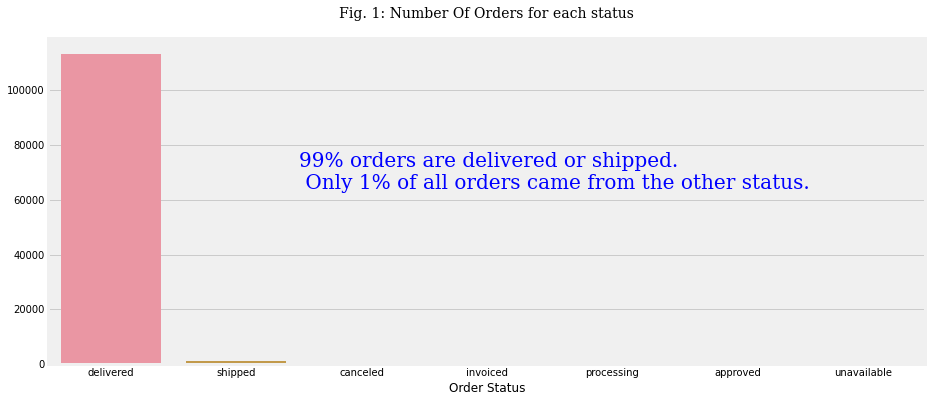

In [13]:
fig = plt.figure(figsize=(14, 6))
ax = sns.countplot(data=olist, x='order_status')
comment = '99% orders are delivered or shipped. \n Only 1% of all orders came from the other status.'
plt.text(x=1.5, y=65000, s=comment, family='serif', color='b', fontsize=20, ha='left', wrap=True)
plt.xlabel('Order Status')
plt.ylabel('')
ax.set_title('Fig. 1: Number Of Orders for each status', size=14, font='serif', pad=20)
plt.show()

*b. Orders through time*

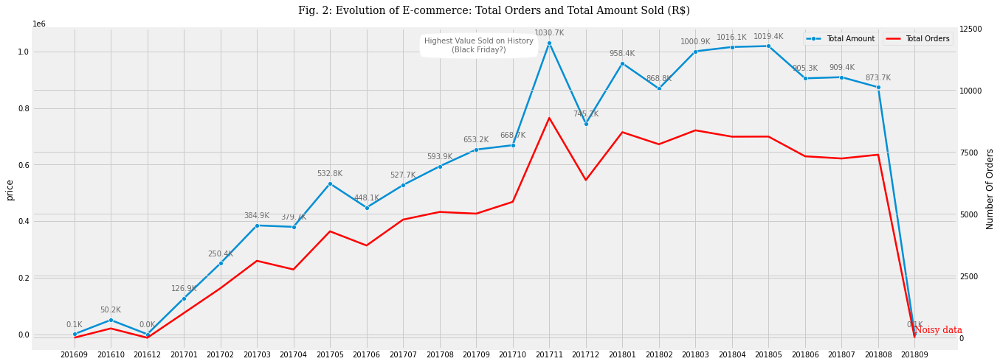

In [26]:
olist_sales_by_year_month = olist.groupby(by=['order_purchase_year', 'order_purchase_year_month'], as_index=False).agg({
    'order_id': 'count',
    'price': 'sum'
})

fig = plt.figure(figsize=(20, 8))
ax = sns.lineplot(x='order_purchase_year_month', y='price', data=olist_sales_by_year_month, linewidth=2.5, marker='o', label='Total Amount')
sns.move_legend(ax, 'upper left', bbox_to_anchor=(0.83, 1))

ax1_twx = ax.twinx()
sns.lineplot(data=olist_sales_by_year_month, x='order_purchase_year_month', y='order_id', color='r', linewidth=2.5, ax=ax1_twx, label='Total Orders')
ax1_twx.set_yticks(np.arange(0, 15000, 2500))
ax1_twx.set_ylabel('Number Of Orders')

for x, y in olist_sales_by_year_month.price.items():
    ax.annotate(str(round(y/1000, 1))+'K', xy=(x, y), textcoords='offset points', xytext=(0, 10), ha='center', color='dimgrey')
ax.annotate('Highest Value Sold on History\n(Black Friday?)', (13.5, 1050000), xytext=(-120, -20), 
             textcoords='offset points', bbox=dict(boxstyle='round4', fc='w', pad=.8),
             arrowprops=dict(arrowstyle='-|>', fc='w'), color='dimgrey', ha='center')
plt.text(x='201809', y=200, s='Noisy data', family='serif', ha='left', fontsize='large', color='red')
ax.set_title('Fig. 2: Evolution of E-commerce: Total Orders and Total Amount Sold (R$)', size=14, font='serif', pad=20)
ax.set_xlabel('')
plt.show()

E-commerce on Brazil really has a growing trend along the time. There is a strong correlation between Revenue and Number of Orders. However, there are some months these metrics change slightly in two different directions such as June-to-August (2018).

*c. Orders through days & hours*

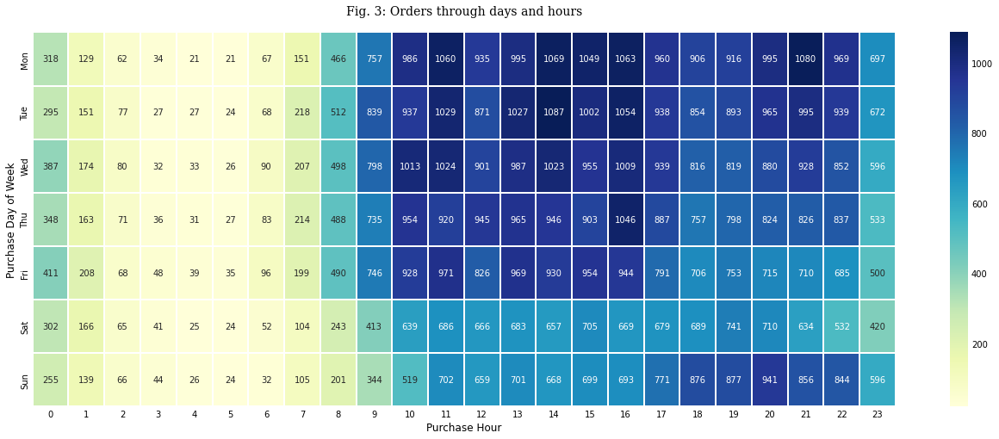

In [15]:
order_day_hour = olist.groupby(['order_purchase_dayofweek', 'order_purchase_hour'])['order_id'].nunique().unstack()
plt.figure(figsize=(20,8))
ax = sns.heatmap(order_day_hour.reindex(index=['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']), cmap="YlGnBu", annot=True, fmt="d", linewidths=0.2)
ax.set_xlabel('Purchase Hour')
ax.set_ylabel('Purchase Day of Week')
ax.set_title('Fig. 3: Orders through days and hours', size=14, font='serif', pad=20)
plt.show()

From the heatmap above, we find that the number of orders decrease gradually from weekdays to weekends. Weekdays, especially on Monday & Tuesday are the preferred days for Brazilian's customers and they tend to buy more at the afternoons. The hottest time slots are Weekdays (10-22h) and Weekends (18-22h).

*d. Orders by product categories*

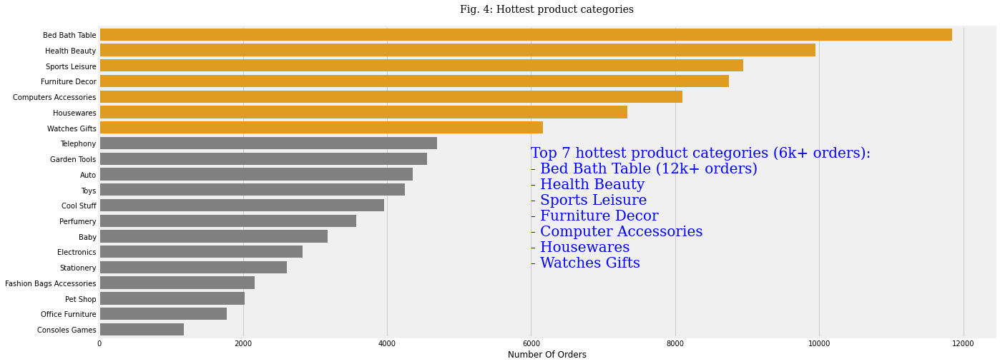

In [16]:
plt.figure(figsize=(20, 8))
order_by_product_categories = (olist
                  .groupby('product_category_name_english')['order_id'].count()
                  .reset_index()
                  .sort_values(by='order_id', ascending=False)
                  .head(20))
colors = ['grey' if (x < 6000) else 'orange' for x in order_by_product_categories.order_id]
ax = sns.barplot(data=order_by_product_categories,
            x='order_id',
            y='product_category_name_english',
            palette=colors
            )

comment = 'Top 7 hottest product categories (6k+ orders): \n- Bed Bath Table (12k+ orders) \n- Health Beauty \n- Sports Leisure \n- Furniture Decor \n- Computer Accessories \n- Housewares \n- Watches Gifts'
plt.text(x=6000, y=15, s=comment, family='serif', color='b', fontsize=20, ha='left')
ax.set_title('Fig. 4: Hottest product categories', size=14, font='serif', pad=20)
plt.xlabel('Number Of Orders')
plt.ylabel('')
plt.show()

I will dive more deeply into details to know about the trend of product categories through time. Because there are many different product categories, dynamic chart in `plotly` will show better insight in this case.

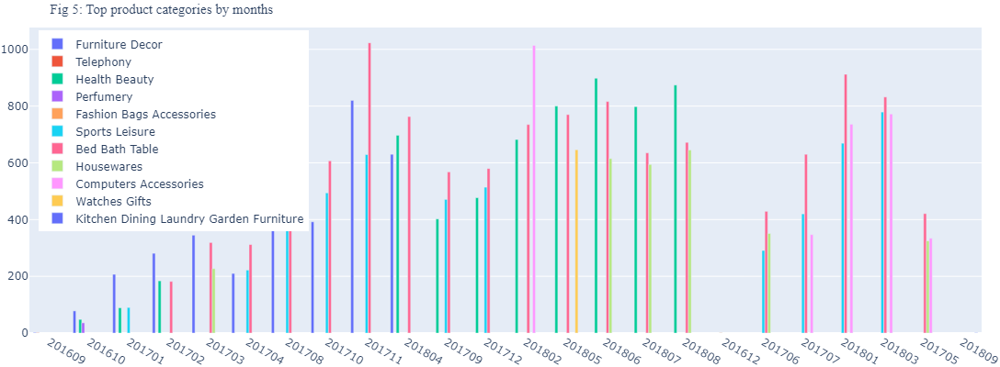

In [17]:
import plotly.graph_objects as go

top_product_categories_by_month = pd.DataFrame(olist
                                               .groupby('order_purchase_year_month')['product_category_name_english']
                                               .apply(lambda x: x.value_counts().head(3)) # top 3 only
                                               .reset_index()
                                               .rename(columns={
                                                   'level_1': 'product_category_name_english', 
                                                   'product_category_name_english': 'product_category_count'
                                               }))
top_categories = top_product_categories_by_month['product_category_name_english'].unique().tolist()

fig = go.Figure(data=[
    go.Bar(name=category, 
           x=top_product_categories_by_month.loc[top_product_categories_by_month.product_category_name_english == category, 'order_purchase_year_month'], 
           y=top_product_categories_by_month.loc[top_product_categories_by_month.product_category_name_english == category, 'product_category_count']) 
    for category in top_categories
])
# Change the bar mode
fig.update_layout(
    barmode='group', 
    autosize=False, 
    title=dict(text='Fig 5: Top product categories by months', font=dict(size=15, family='serif')),
    width=1050, height=400, 
    margin=dict(l=10, r=0, t=30, b=0),
    legend=dict(yanchor='top', y=0.99, xanchor='left', x=0.01)
)
fig.show()

We could find that `Bed Bath Table` is the best-seller product category of all time. Products in `Furniture Decor` are quite "hot" before 2018, while `Health Beauty` and `Housewares` products are more popular from April to the end of 2018. `Computers Accessories` products are quite seasonal and only hot in the early part of 2018.

#### 2.3. Sales analysis

Now, we'll analyze ecommerce cash flow by looking at order prices, shipping rates, and more.

In [18]:
olist_sales_by_states = olist.groupby(by=['customer_state'], as_index=False).agg({
    'order_id': 'count', # number of orders 
    'price': 'sum', # total amount
    'freight_value': ['sum', 'mean'], # total /mean freight amount
    'time_to_delivery': 'mean',
    'delivery_against_estimated': 'mean'
})
updated_columns = []
for e in olist_sales_by_states.columns: 
    if (e[0] == 'freight_value'):
        updated_columns.append(e[0] + '_' + e[1])
    else:
        updated_columns.append(e[0])
olist_sales_by_states.columns = updated_columns

olist_sales_by_states['price_per_order'] = olist_sales_by_states['price'] / olist_sales_by_states['order_id']
olist_sales_by_states['freight_per_order'] = olist_sales_by_states['freight_value_sum'] / olist_sales_by_states['order_id']

for c in  ['price', 'freight_value_sum', 'price_per_order', 'freight_per_order']:
    olist_sales_by_states[c] = olist_sales_by_states[c].apply(round)

*a. Sales by state*

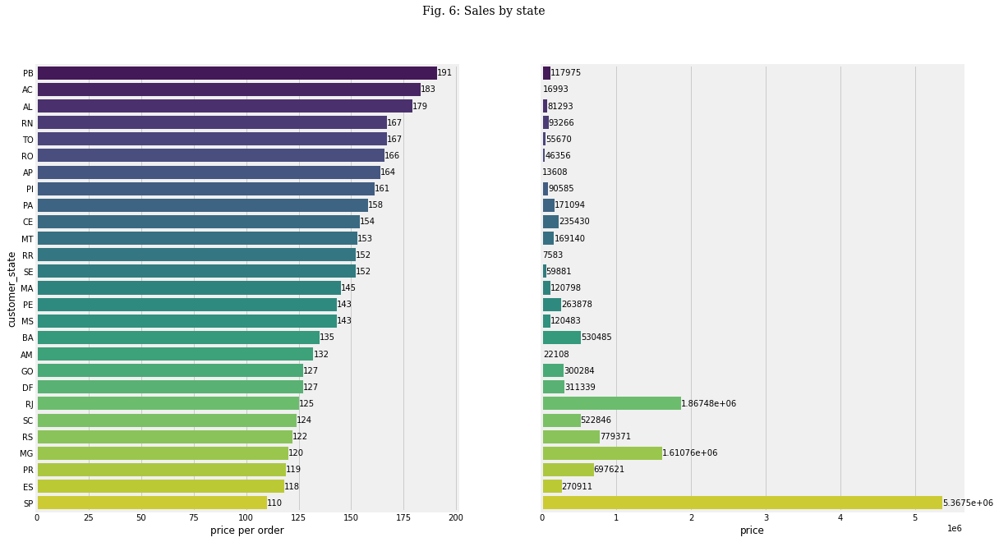

In [19]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 10), sharey=True)
sns.barplot(data=olist_sales_by_states.sort_values(by='price_per_order', ascending=False), 
            x='price_per_order', y='customer_state', ax=ax1, palette='viridis')
sns.barplot(data=olist_sales_by_states.sort_values(by='price_per_order', ascending=False), 
            x='price', y='customer_state', ax=ax2, palette='viridis')
ax1.bar_label(ax1.containers[0], fontsize=10)
ax1.set_xlabel('price per order')
ax2.bar_label(ax2.containers[0], fontsize=10)
ax2.set_ylabel('')
fig.suptitle('Fig. 6: Sales by state', size=14, font='serif')
plt.show()

Some states have a high total amount sold and a low price per order. For example, SP (São Paulo) is the most valuable state for e-commerce (5M+ sold) but also where customers pay less per order (110 per order).

*b. Freight value by time*

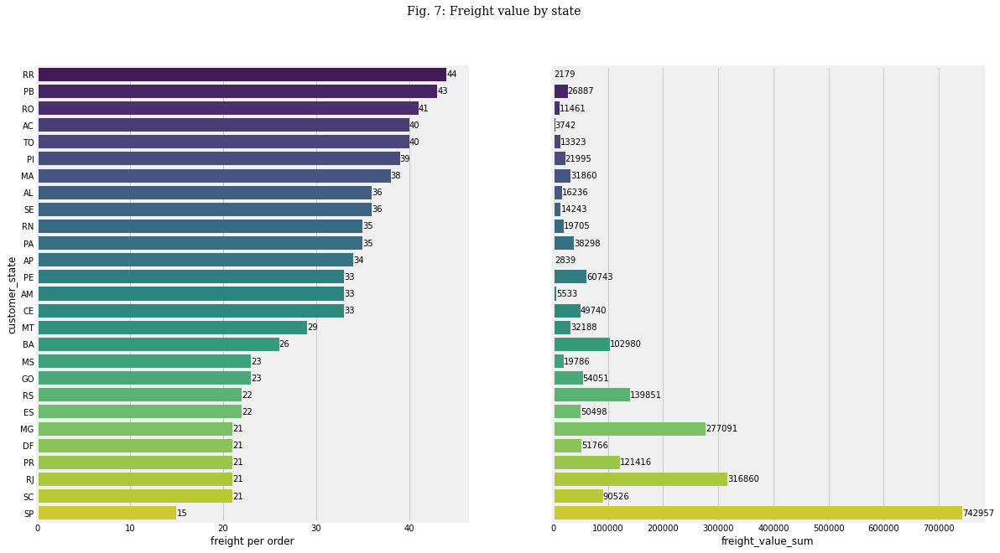

In [20]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 10), sharey=True)
sns.barplot(data=olist_sales_by_states.sort_values(by='freight_per_order', ascending=False), 
            x='freight_per_order', y='customer_state', ax=ax1, palette='viridis')
sns.barplot(data=olist_sales_by_states.sort_values(by='freight_per_order', ascending=False), 
            x='freight_value_sum', y='customer_state', ax=ax2, palette='viridis')
ax1.bar_label(ax1.containers[0], fontsize=10)
ax1.set_xlabel('freight per order')
ax2.bar_label(ax2.containers[0], fontsize=10)
ax2.set_ylabel('')
fig.suptitle('Fig. 7: Freight value by state', size=14, font='serif')
plt.show()

We could see that customers in Roraima (RR), Paraíba (PB), Rondônia (RO) and Acre (AC) normally pays more than anyone on freights.

*c. What are the best states to buy in Brazil?*

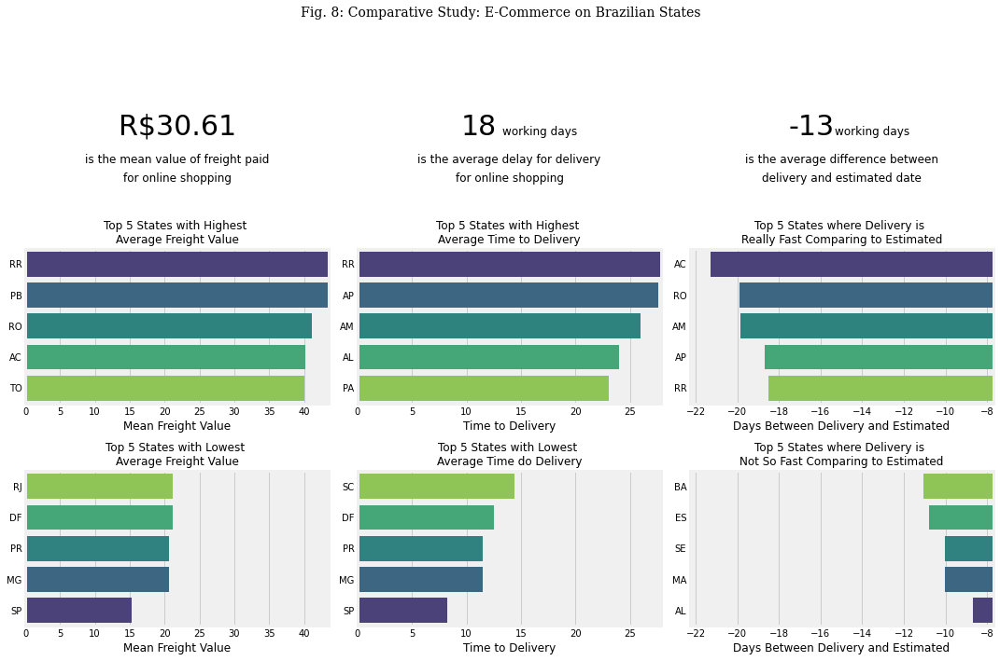

In [21]:
fig, axs = plt.subplots(3, 3, figsize=(15, 10))

# Plot Pack 01 - Freight value paid on states
sns.barplot(x='freight_value_mean', y='customer_state', data=olist_sales_by_states.sort_values(by='freight_value_mean', ascending=False).head(), ax=axs[1, 0], palette='viridis')
axs[1, 0].set_title('Top 5 States with Highest \nAverage Freight Value', size=12, color='black')
sns.barplot(x='freight_value_mean', y='customer_state', data=olist_sales_by_states.sort_values(by='freight_value_mean', ascending=False).tail(), ax=axs[2, 0], palette='viridis_r')
axs[2, 0].set_title('Top 5 States with Lowest \nAverage Freight Value', size=12, color='black')
for ax in axs[1, 0], axs[2, 0]:
    ax.set_xlabel('Mean Freight Value')
    ax.set_xlim(0, olist_sales_by_states['freight_value_mean'].max())
    ax.set_ylabel('')

# Annotations
axs[0, 0].text(0.50, 0.30, f'R${round(olist_sales_by_states.freight_value_mean.mean(), 2)}', fontsize=30, ha='center')
axs[0, 0].text(0.50, 0.12, 'is the mean value of freight paid', fontsize=12, ha='center')
axs[0, 0].text(0.50, 0.00, 'for online shopping', fontsize=12, ha='center')
axs[0, 0].axis('off')

# Plot Pack 02 - Time to delivery on states
sns.barplot(x='time_to_delivery', y='customer_state', data=olist_sales_by_states.sort_values(by='time_to_delivery', ascending=False).head(), ax=axs[1, 1], palette='viridis')
axs[1, 1].set_title('Top 5 States with Highest \nAverage Time to Delivery', size=12, color='black')
sns.barplot(x='time_to_delivery', y='customer_state', data=olist_sales_by_states.sort_values(by='time_to_delivery', ascending=False).tail(), ax=axs[2, 1], palette='viridis_r')
axs[2, 1].set_title('Top 5 States with Lowest \nAverage Time do Delivery', size=12, color='black')
for ax in axs[1, 1], axs[2, 1]:
    ax.set_xlabel('Time to Delivery')
    ax.set_xlim(0, olist_sales_by_states['time_to_delivery'].max())
    ax.set_ylabel('')
    
# Annotations
axs[0, 1].text(0.40, 0.30, f'{int(olist_sales_by_states.time_to_delivery.mean())}', fontsize=30, ha='center')
axs[0, 1].text(0.60, 0.30, 'working days', fontsize=12, ha='center')
axs[0, 1].text(0.50, 0.12, 'is the average delay for delivery', fontsize=12, ha='center')
axs[0, 1].text(0.50, 0.00, 'for online shopping', fontsize=12, ha='center')
axs[0, 1].axis('off')
    
# Plot Pack 03 - Differnece between delivered and estimated on states
sns.barplot(x='delivery_against_estimated', y='customer_state', data=olist_sales_by_states.sort_values(by='delivery_against_estimated').head(), ax=axs[1, 2], palette='viridis')
axs[1, 2].set_title('Top 5 States where Delivery is \nReally Fast Comparing to Estimated', size=12, color='black')
sns.barplot(x='delivery_against_estimated', y='customer_state', data=olist_sales_by_states.sort_values(by='delivery_against_estimated').tail(), ax=axs[2, 2], palette='viridis_r')
axs[2, 2].set_title('Top 5 States where Delivery is \nNot So Fast Comparing to Estimated', size=12, color='black')
for ax in axs[1, 2], axs[2, 2]:
    ax.set_xlabel('Days Between Delivery and Estimated')
    ax.set_xlim(olist_sales_by_states['delivery_against_estimated'].min()-1, 
                olist_sales_by_states['delivery_against_estimated'].max()+1)
    ax.set_ylabel('')

# Annotations
axs[0, 2].text(0.40, 0.30, f'{int(olist_sales_by_states.delivery_against_estimated.mean())}', fontsize=30, ha='center')
axs[0, 2].text(0.60, 0.30, 'working days', fontsize=12, ha='center')
axs[0, 2].text(0.50, 0.12, 'is the average difference between', fontsize=12, ha='center')
axs[0, 2].text(0.50, 0.00, 'delivery and estimated date', fontsize=12, ha='center')
axs[0, 2].axis('off') 
    
plt.suptitle('Fig. 8: Comparative Study: E-Commerce on Brazilian States', size=14, font='serif')
plt.tight_layout()
plt.show()

It looks like delivery system in `SP`, `MG`, `PR` and `DF` states is very good, where customers can place orders at the lowest price shipping rates & receive orders very quickly (within 2 weeks in average).

#### 2.4. Rating Analysis

*a. Rating by time*

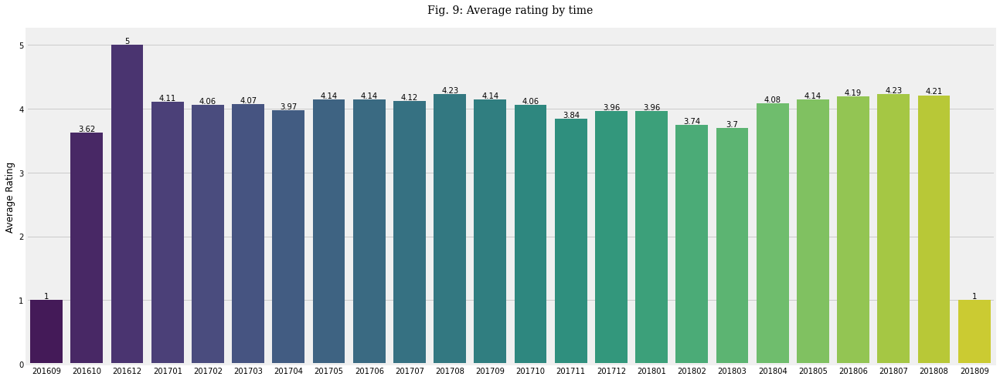

In [22]:
avg_rating_by_year_month = olist.groupby('order_purchase_year_month')['review_score'].mean().reset_index()
avg_rating_by_year_month['review_score'] = avg_rating_by_year_month['review_score'].apply(lambda x: round(x, 2))

fig = plt.figure(figsize=(20, 8))
ax = sns.barplot(x='order_purchase_year_month', y='review_score', data=avg_rating_by_year_month, label='Average Rating', palette='viridis')
ax.bar_label(ax.containers[0], fontsize=10)
ax.set_title('Fig. 9: Average rating by time', size=14, font='serif', pad=20)
ax.set_xlabel('')
ax.set_ylabel('Average Rating')
plt.show()

If we ignore data before 2017 and 09/2018 because the number of orders is too small (and rating will be biased), we could find that rating for orders are quite stable `between 3.95 and 4.2`. The rating drop in Nov-2017 and Feb, Mar-2018.

*b. Rating by categories*

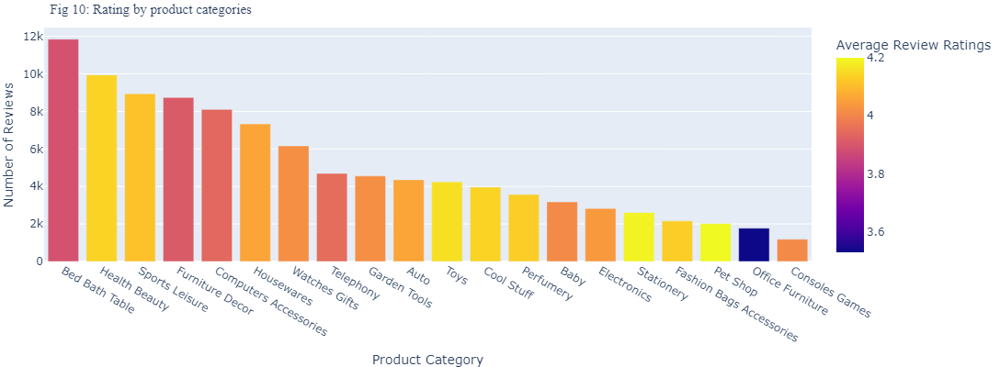

In [23]:
avg_score_per_category = olist.groupby('product_category_name_english', as_index=False).agg({'review_score': ['count', 'mean']})
avg_score_per_category.columns = ['Product Category', 'Number of Reviews', 'Average Review Ratings']
avg_score_per_category['Average Review Ratings'] = avg_score_per_category['Average Review Ratings'].apply(lambda x: round(x, 2))

# filtering to show only top categories with more than 100 reviews
avg_score_per_category = (avg_score_per_category[avg_score_per_category['Number of Reviews'] > 100]
                          .sort_values(by='Number of Reviews', ascending=False)[:20])

fig = px.bar(avg_score_per_category, x='Product Category', y='Number of Reviews',
             hover_data=['Average Review Ratings'], color='Average Review Ratings')

fig.update_layout(
    title=dict(text='Fig 10: Rating by product categories', font=dict(size=15, family='serif')),
    width=1050, height=400, 
    margin=dict(l=10, r=0, t=30, b=0),
    legend=dict(yanchor='top', y=0.99, xanchor='left', x=0.01)
)
fig.show()

Among the top 7 best-selling products (also most reviews), `Bed Bad Table` has the lowest rating (3.89). The highest rating (>4.1) belongs to the 2nd and 3rd best-selling product groups (`Health Beauty` and `Sports Leisure`).

#### 2.5. Payment Type Analysis

We can build a mini-dashboard with main concepts: payments type and payments installments, which aims to present enough information to clarify how e-commerce buyers usually prefer to pay orders.

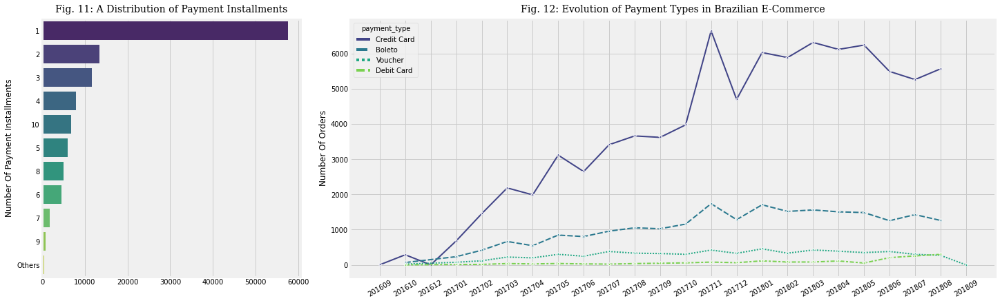

In [24]:
def normalize_payment_installments(x):
    if x in range(1, 11):
        return str(x)
    else:
        return 'Others'
        
olist['payment_installments_normalized'] = olist['payment_installments'].apply(normalize_payment_installments)

fig, (ax1, ax2) = plt.subplots(1, 2, constrained_layout=True, figsize=(20, 6), gridspec_kw={'width_ratios': [2, 5]})

# Plot 1 - Distribution of Payment Installments
payment_installments_distribution = olist['payment_installments_normalized'].value_counts().reset_index()
sns.barplot(data=payment_installments_distribution, x='payment_installments_normalized', y='index', palette='viridis', ax=ax1)
ax1.set_title('Fig. 11: A Distribution of Payment Installments', size=14, font='serif', pad=10)
ax1.set_ylabel('Number Of Payment Installments')
ax1.set_xlabel('')

# Plot 2 - Evolution of payment types
payment_type_evolution = (olist.groupby(by=['order_purchase_year_month', 'payment_type'], as_index=False)
                          .count()
                          .sort_values(by=['order_purchase_year_month', 'order_id'], ascending=[True, False]))

sns.lineplot(x='order_purchase_year_month', y='order_id', data=payment_type_evolution, ax=ax2, hue='payment_type',
             style='payment_type', palette='viridis', marker='*', linewidth=2)
ax2.set_title('Fig. 12: Evolution of Payment Types in Brazilian E-Commerce', size=14, font='serif', pad=10)
plt.xticks(rotation=30)
ax2.set_xlabel('')
ax2.set_ylabel('Number Of Orders')
plt.show()

We can see that payments made by `credit card` really took majority place on Brazilian e-commerce. Since Mar-2018 it's a little decrease on this type of payment. On the other side, payments made by `debit card` is showing a growing trend since May-2018, which is a good opportunity for investor to improve services for payments like this.

On the bar chart above, we can see how Brazilian customers prefer to pay the orders: most of them pay once into 1 installment and it's worth to point out the quantity of payments done by 10 installments.

In [25]:
# EDA template (for summary): https://enshrined-texture-7af.notion.site/Exploratory-Data-Analysis-Project-c850e8fc48f546bf9826fa1a2cd8ccf1
# jupyter nbconvert --no-input --to pdf 1_EDA.ipynb